## **LECTURA DE DATOS**

In [3]:
import geopandas as gpd
import pandas as pd
australia_link='https://github.com/Tracy-12/TAREA_GRUPAL_3/raw/refs/heads/main/mapas%20obtenidos/australiaMaps_3112.gpkg'
ports=pd.read_csv('https://github.com/CienciaDeDatosEspacial/GeoDataFrame_Analytics/raw/main/data/UpdatedPub150.csv')
border=gpd.read_file(australia_link,layer='border')
gpd.list_layers(australia_link)

,name,geometry_type
0,country,MultiPolygon
1,cities,Point
2,rivers,MultiLineString
3,airports,Point
4,border,MultiLineString


## **EJERCICIO 1**

In [4]:
ports.columns

Index(['World Port Index Number', 'Region Name', 'Main Port Name',
       'Alternate Port Name', 'UN/LOCODE', 'Country Code', 'World Water Body',
       'IHO S-130 Sea Area', 'Sailing Direction or Publication',
       'Publication Link',
       ...
       'Supplies - Fuel Oil', 'Supplies - Diesel Oil',
       'Supplies - Aviation Fuel', 'Supplies - Deck', 'Supplies - Engine',
       'Repairs', 'Dry Dock', 'Railway', 'Latitude', 'Longitude'],
      dtype='object', length=108)

In [5]:
airports=gpd.read_file(australia_link,layer='airports')
ports.rename(columns={'Main Port Name':'portName'},inplace=True)
ports=ports.loc[:,['portName', 'Country Code','Latitude', 'Longitude']]
ports.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3739 entries, 0 to 3738
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   portName      3739 non-null   object 
 1   Country Code  3739 non-null   object 
 2   Latitude      3739 non-null   float64
 3   Longitude     3739 non-null   float64
dtypes: float64(2), object(2)
memory usage: 117.0+ KB


In [6]:
seaports=gpd.GeoDataFrame(data=ports.copy(),
                           geometry=gpd.points_from_xy(ports.Longitude,
                                                       ports.Latitude),
                          crs=4326)
seaports_aus=seaports[seaports['Country Code']=='Australia'].copy()
seaports_aus.reset_index(drop=True, inplace=True)
seaports_aus_3112=seaports_aus.to_crs(3112)

In [7]:
seaports_aus_3112.head()

,portName,Country Code,Latitude,Longitude,geometry
0,Dover,Australia,-43.316667,147.033333,POINT (1087783.364 -4930315.345)
1,Burnie,Australia,-41.050000,145.950000,POINT (1022145.796 -4664513.364)
2,Ballina,Australia,-28.866667,153.566667,POINT (1878859.725 -3411689.117)
3,Beauty Point,Australia,-41.150000,146.816667,POINT (1094875.552 -4683076.964)
4,Lucinda,Australia,-18.516667,146.333333,POINT (1298466.288 -2193115.291)


In [8]:
largeAirports=airports[airports['kind']=='large_airport']
largeAirports.reset_index(drop=True, inplace=True)
largeAirports.head()

,name,kind,latitude_deg,longitude_deg,elevation_ft,municipality,geometry
0,Brisbane International Airport,large_airport,-27.384199,153.117004,13.0,Brisbane,POINT (1860613.688 -3244612.198)
1,Melbourne Airport,large_airport,-37.661548,144.836432,434.0,Melbourne,POINT (959922.488 -4276694.309)
2,Adelaide International Airport,large_airport,-34.947512,138.533393,20.0,Adelaide,POINT (412864.26 -3941270.535)
3,Darwin International Airport / RAAF Darwin,large_airport,-12.414970,130.881850,103.0,Darwin,POINT (-345664.176 -1452918.314)
4,Perth International Airport,large_airport,-31.940300,115.967003,67.0,Perth,POINT (-1684432.427 -3723348.148)


In [9]:
seaports_aus_3112.set_index('portName').geometry.apply\
(lambda g: largeAirports.set_index('name').geometry.distance(g)/1000).\
sort_index(axis=0).sort_index(axis=1)

name,Adelaide International Airport,Brisbane International Airport,Darwin International Airport / RAAF Darwin,Melbourne Airport,Perth International Airport,Sydney Kingsford Smith International Airport
portName,,,,,,
Albany,1878.175154,3416.684096,2815.472432,2434.582964,384.225804,3039.604161
Ardrossan,80.019657,1631.980784,2529.626327,719.069619,2049.116205,1217.362816
Ballina,1558.717159,168.070267,2963.998927,1262.014116,3576.895625,601.710321
Batemans Bay,1058.736672,955.463941,3212.250154,524.799195,3166.158422,214.750284
Beauty Point,1007.678609,1629.581473,3536.817723,428.204614,2940.345598,892.228278
...,...,...,...,...,...,...
Weipa,2479.501024,2002.647513,1216.555606,2773.920364,3383.577441,2527.090502
Welshpool,823.014372,1392.130776,3284.246655,184.831298,2859.408875,676.801398
Western Port,709.393357,1413.245949,3195.164448,84.528120,2746.504332,724.749851


In [10]:
distanceMatrixKM_sea_air= seaports_aus_3112.set_index('portName').geometry.apply\
                          (lambda g: largeAirports.set_index('name').geometry.distance(g)/1000).\
                          sort_index(axis=0).sort_index(axis=1)

In [11]:
port_point = seaports_aus_3112[seaports_aus_3112['portName'] == 'Albany']
closest_point1=largeAirports[largeAirports['name']== 'Perth International Airport']
closest_point2=largeAirports[largeAirports['name']== 'Adelaide International Airport']

<Axes: >

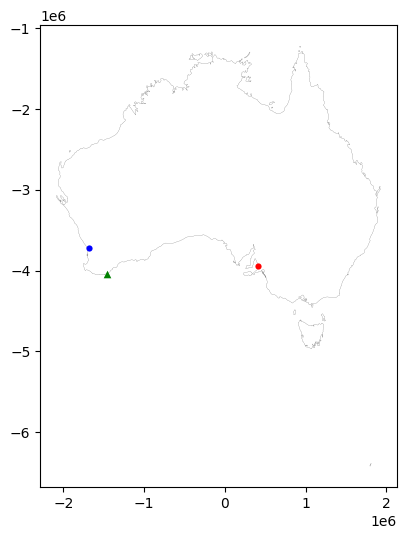

In [12]:
base = border.plot(facecolor="white",
                      edgecolor='black',
                      linewidth=0.1,
                      figsize=(6,6))
port_point.plot(facecolor='green',linewidth=0,marker="^",
            ax=base, markersize=30, zorder=5)
closest_point1.plot(facecolor='blue',linewidth=0,
            ax=base, markersize=20, zorder=5)
closest_point2.plot(facecolor='red',linewidth=0,
            ax=base, markersize=20, zorder=5)

## **EJERCICIO 2**

In [13]:
eletricity_lines=gpd.read_file('https://github.com/Tracy-12/TAREA_GRUPAL_3/raw/refs/heads/main/Electricity_Transmission_lines/Electricity_Transmission_Lines.shp')
liquid_fluel_terminals=gpd.read_file('https://github.com/Tracy-12/TAREA_GRUPAL_3/raw/refs/heads/main/Liquid_fuel_terminals/Liquid_Fuel_Terminals.shp')
countries=gpd.read_file('https://github.com/Tracy-12/TAREA_GRUPAL_3/raw/refs/heads/main/World_Countries/World_Countries.shp')

In [14]:
australia=countries[countries.COUNTRY=='Australia']
liquid_fluel_terminals=liquid_fluel_terminals.set_crs(epsg=4326, allow_override=True)
liquid_fluel_terminals_clipped=gpd.clip(liquid_fluel_terminals,australia)
liquid_fluel_terminals_3112=liquid_fluel_terminals_clipped.to_crs(3112)
decommissioned_terminals=liquid_fluel_terminals_3112[liquid_fluel_terminals_3112.operationa=='Decommissioned']

In [15]:
eletricity_lines=eletricity_lines.set_crs(epsg=4326, allow_override=True)
eletricity_lines_clipped=gpd.clip(eletricity_lines,australia)
eletricity_lines_3112=eletricity_lines_clipped.to_crs(3112)

In [16]:
#Solo se trabaja con una linea de un estado estado
single_line = eletricity_lines_3112[eletricity_lines_3112['name'] == 'Sydney West to Bannaby']
distanceMatrixKM_elec_term=single_line.set_index('name').geometry.apply\
(lambda g: decommissioned_terminals.set_index('name').geometry.distance(g)/1000).\
sort_index(axis=0)
distanceMatrixKM_elec_term

name,Newport,Botany,Birkenhead,Newcastle,Bundaberg,Townsville,Karumba,Fremantle
name,,,,,,,,
Sydney West to Bannaby,597.794519,38.694289,1055.338487,130.229928,1003.238753,1642.864355,2044.071122,3177.302682


In [17]:
#!pip install folium matplotlib mapclassify

In [18]:
closest_terminal=decommissioned_terminals[decommissioned_terminals['name']=='Botany']
farthest_terminal = decommissioned_terminals[decommissioned_terminals['name'] == 'Fremantle']

In [21]:
!pip install folium matplotlib mapclassify

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 286.7/286.7 kB 18.4 MB/s eta 0:00:00


In [22]:
base=single_line.explore()
closest_terminal.explore(m=base,color='red',marker_kwds=dict(radius=10))
farthest_terminal.explore(m=base, color='purple', marker_kwds=dict(radius=10))

**EJERCICIO 3**

In [23]:
#Se junta la data de lineas por estado
electricity_lines_by_state=eletricity_lines_3112.dissolve(by='state')
electricity_lines_by_state.reset_index(drop=False,inplace=True)
electricity_lines_by_state.drop(columns=['length_m','objectid','featuretyp','descriptio','class','name','name','spatialcon','revised','ga_guid','comment_','st_lengths'],inplace=True)
electricity_lines_New_South_Wales=electricity_lines_by_state[electricity_lines_by_state['state']=='New South Wales']

In [24]:
electricity_lines_New_South_Wales.convex_hull

,0
1,"POLYGON ((1414735.513 -4265409.239, 967413.224..."


<Axes: >

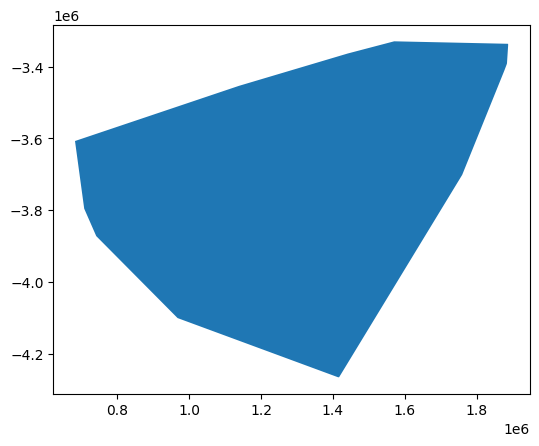

In [25]:
electricity_lines_New_South_Wales.convex_hull.plot()

In [26]:
lines_SWales_hulls=electricity_lines_New_South_Wales.convex_hull.to_frame()
lines_SWales_hulls['State']=['New South Wales']
lines_SWales_hulls.rename(columns={0:'geometry'},inplace=True)
lines_SWales_hulls=lines_SWales_hulls.set_geometry('geometry')
lines_SWales_hulls

,geometry,State
1,"POLYGON ((1414735.513 -4265409.239, 967413.224...",New South Wales


In [27]:
distanceMatrixKM_linesHull_fluel=lines_SWales_hulls.set_index('State').geometry.apply\
(lambda g: decommissioned_terminals.set_index('name').geometry.distance(g)/1000).\
sort_index(axis=1)
distanceMatrixKM_linesHull_fluel

name,Birkenhead,Botany,Bundaberg,Fremantle,Karumba,Newcastle,Newport,Townsville
State,,,,,,,,
New South Wales,324.421223,0.0,384.478317,2388.472819,1476.642103,0.0,185.535614,1073.945797


In [28]:
closest_terminal_1=decommissioned_terminals[decommissioned_terminals['name']=='Botany']
closest_terminal_2=decommissioned_terminals[decommissioned_terminals['name']=='Newcastle']
farthest_terminal_1= decommissioned_terminals[decommissioned_terminals['name'] == 'Fremantle']

In [29]:
base=lines_SWales_hulls.explore()
mins = distanceMatrixKM_linesHull_fluel.idxmin(axis=1)
closest_terminal_1.explore(m=base,color='red',marker_kwds=dict(radius=10))
closest_terminal_2.explore(m=base,color='red',marker_kwds=dict(radius=10))
farthest_terminal_1.explore(m=base, color='purple', marker_kwds=dict(radius=10))

## **EJERCICIO 4**

In [30]:
airports

/usr/local/lib/python3.11/dist-packages/google/colab/_dataframe_summarizer.py:57: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  pd.to_datetime(column, errors="raise")


,name,kind,latitude_deg,longitude_deg,elevation_ft,municipality,geometry
0,Argyle Downs Airport,small_airport,-16.508604,128.922485,407.0,Argyle Downs,POINT (-544268.865 -1917793.807)
1,Angus Downs Airport,small_airport,-25.032500,132.274800,1724.0,Angus Downs Station,POINT (-172087.264 -2846597.417)
2,Hopetoun Airfield,closed,-33.908501,120.147003,NaN,Hopetoun,POINT (-1271965.498 -3889204.632)
3,Dwellingup Airstrip,small_airport,-32.692699,116.074997,NaN,Dwellingup,POINT (-1662649.636 -3803821.329)
4,Tjukayirla Roadhouse Airstrip,small_airport,-27.155199,124.584999,1425.0,Cosmo Newbery,POINT (-920899.555 -3112269.058)
...,...,...,...,...,...,...,...
2749,Yarrawonga Airport,small_airport,-36.028900,146.029007,423.0,None,POINT (1082617.757 -4105488.7)
2750,Mugarinya Airport,small_airport,-21.285426,118.385282,439.0,Yandeyarra Station,POINT (-1604526.014 -2534299.095)
2751,Zanthus Airport,small_airport,-31.036351,123.567889,NaN,None,POINT (-984908.515 -3543899.565)
2752,Churchable Airstrip,small_airport,-27.429915,152.378454,NaN,Churchable,POINT (1788526.725 -3238837.645)


In [31]:
small_airport=airports[airports['kind']=='small_airport']
small_airport.reset_index(drop=True, inplace=True)
small_airport.head()

,name,kind,latitude_deg,longitude_deg,elevation_ft,municipality,geometry
0,Argyle Downs Airport,small_airport,-16.508604,128.922485,407.0,Argyle Downs,POINT (-544268.865 -1917793.807)
1,Angus Downs Airport,small_airport,-25.032500,132.274800,1724.0,Angus Downs Station,POINT (-172087.264 -2846597.417)
2,Dwellingup Airstrip,small_airport,-32.692699,116.074997,NaN,Dwellingup,POINT (-1662649.636 -3803821.329)
3,Tjukayirla Roadhouse Airstrip,small_airport,-27.155199,124.584999,1425.0,Cosmo Newbery,POINT (-920899.555 -3112269.058)
4,Langley Park Airstrip,small_airport,-31.961229,115.867867,11.0,Perth,POINT (-1693297.64 -3726957.208)


In [32]:
electricity_lines_by_state

,state,geometry,operationa,capacitykv
0,Australian Capital Territory,"MULTILINESTRING ((1365976.343 -4064288.851, 13...",Operational,132
1,New South Wales,"MULTILINESTRING ((997652.205 -4045143.527, 997...",Operational,66
2,Northern Territory,"MULTILINESTRING ((-17246.151 -2719395.622, -17...",Operational,22
3,Queensland,"MULTILINESTRING ((1632865.141 -3271177.923, 16...",Operational,132
4,South Australia,"MULTILINESTRING ((602142.421 -4271382.784, 602...",Operational,132
5,Tasmania,"MULTILINESTRING ((1094650.002 -4897241.888, 10...",Operational,110
6,Victoria,"MULTILINESTRING ((966851.434 -4352817.646, 966...",Operational,66
7,Western Australia,"MULTILINESTRING ((-1494032.542 -3993308.124, -...",Operational,132


In [33]:
electricity_lines_Victoria=eletricity_lines[eletricity_lines['state']=='Victoria']

In [34]:
single_line_proyected = electricity_lines_Victoria.to_crs(epsg=3112)
bufferAroundNSWalles=single_line_proyected.buffer(distance = 9000)
bufferAsBase=bufferAroundNSWalles.explore(color='red')
single_line_proyected.explore(m=bufferAsBase,color='blue',style_kwds={'weight':3})
small_airport.explore(m=bufferAsBase,color='black')

In [35]:
linesWithinBuffer=small_airport.clip(mask=bufferAroundNSWalles)
linesWithinBuffer

,name,kind,latitude_deg,longitude_deg,elevation_ft,municipality,geometry
1912,Tyabb Airport,small_airport,-38.266826,145.179406,88.0,Tyabb,POINT (984219.277 -4346691.366)
299,Bellbrae private airstrip,small_airport,-38.326970,144.236209,NaN,BellBrae,POINT (900826.518 -4346318.876)
1895,Torquay Airport,small_airport,-38.299999,144.365005,9.0,Torquay,POINT (912384.013 -4344241.845)
743,Barwon Heads Airport,small_airport,-38.256145,144.427895,50.0,Connewarre,POINT (918313.694 -4339812.929)
1115,George Town Airport,small_airport,-41.079491,146.839061,131.0,George Town,POINT (1097595.898 -4675332.653)
...,...,...,...,...,...,...,...
1684,Prairie Airport,small_airport,-36.307201,144.139008,NaN,None,POINT (910430.525 -4121278.018)
1467,Moama Airstrip,small_airport,-36.074459,144.764485,310.0,None,POINT (968672.377 -4100203.665)
1696,Pyramid Hill Airport,small_airport,-36.060618,144.126763,NaN,None,POINT (911537.012 -4093902.272)
861,Cohuna Airport,small_airport,-35.826478,144.213812,NaN,None,POINT (921464.156 -4068646.543)


<Axes: >

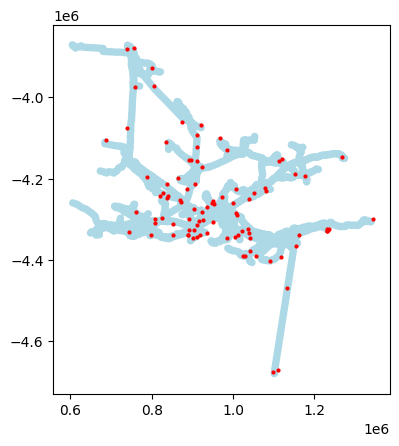

In [36]:
base=bufferAroundNSWalles.plot(color='lightblue')
linesWithinBuffer.plot(ax=base,color='red',markersize=4)

In [37]:
single_line_proyected = electricity_lines_Victoria.to_crs(epsg=3112)
bufferAroundNSWalles=single_line_proyected.buffer(distance = 9000)
bufferAsBase=bufferAroundNSWalles.explore(color='red')
single_line_proyected.explore(m=bufferAsBase,color='blue',style_kwds={'weight':3})
linesWithinBuffer.explore(m=bufferAsBase,color='black')